My side project- Wine Project

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt 
import numpy as np 
import seaborn as sns 
import plotly.express as px

from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer

pd.set_option('display.max_colwidth', None)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# 1. Data loading

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Colab_Notebooks/winemag-data-130k-v2.csv', index_col=0)

In [ ]:
#data unsderstanidng: how many missing values and unique values in the df

def summary_table(df):
    print(f"Dataset Shape: {df.shape}")
    summary = pd.DataFrame(df.dtypes,columns=['dtypes'])
    summary = summary.reset_index()
    summary['Name'] = summary['index']
    summary = summary[['Name','dtypes']]
    summary['Missing'] = df.isnull().sum().values    
    summary['Uniques'] = df.nunique().values
    return summary

In [ ]:
summary_table(df)

Dataset Shape: (129971, 13)


,Name,dtypes,Missing,Uniques
0,country,object,63,43
1,description,object,0,119955
2,designation,object,37465,37979
3,points,int64,0,21
4,price,float64,8996,390
5,province,object,63,425
6,region_1,object,21247,1229
7,region_2,object,79460,17
8,taster_name,object,26244,19
9,taster_twitter_handle,object,31213,15


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 129971 entries, 0 to 129970
Data columns (total 13 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   country                129908 non-null  object 
 1   description            129971 non-null  object 
 2   designation            92506 non-null   object 
 3   points                 129971 non-null  int64  
 4   price                  120975 non-null  float64
 5   province               129908 non-null  object 
 6   region_1               108724 non-null  object 
 7   region_2               50511 non-null   object 
 8   taster_name            103727 non-null  object 
 9   taster_twitter_handle  98758 non-null   object 
 10  title                  129971 non-null  object 
 11  variety                129970 non-null  object 
 12  winery                 129971 non-null  object 
dtypes: float64(1), int64(1), object(11)
memory usage: 13.9+ MB


##filter NA

In [ ]:
#how many na:
df.isna().sum()

country                     63
description                  0
designation              37465
points                       0
price                     8996
province                    63
region_1                 21247
region_2                 79460
taster_name              26244
taster_twitter_handle    31213
title                        0
variety                      1
winery                       0
dtype: int64

In [ ]:
df = df[df['country'].notna()]

#keep only rows with price
df = df[df['price'].notna()]
df.isna().sum()

country                      0
description                  0
designation              34768
points                       0
price                        0
province                     0
region_1                 19516
region_2                 70624
taster_name              24496
taster_twitter_handle    29416
title                        0
variety                      1
winery                       0
dtype: int64

# 2. EDA

## country feature

In [ ]:
#set column as categorical
df['country'] = df.country.astype('category')
df.country.nunique()

42

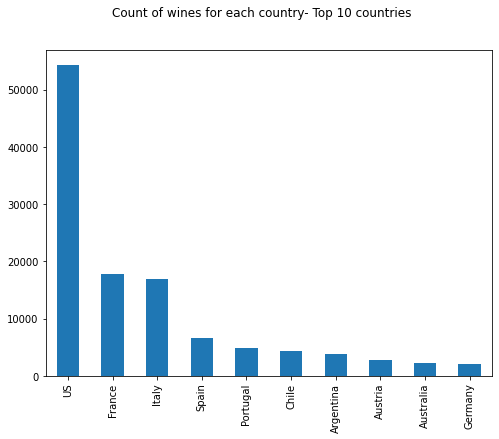

In [ ]:
fig = plt.figure(figsize = (8,6))
fig.suptitle('Count of wines for each country- Top 10 countries')

df['country'].value_counts()[:10].plot(kind='bar')


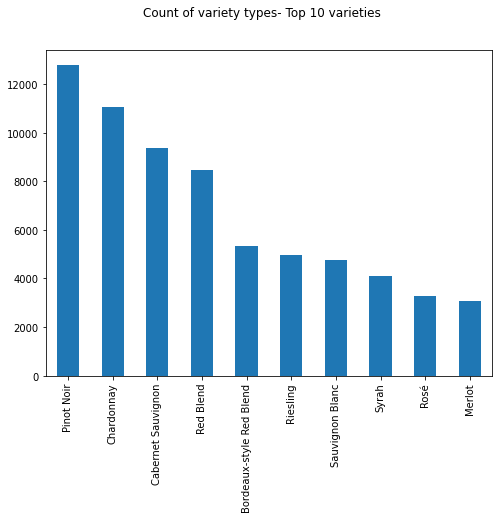

In [ ]:
#plot of veraity types-top 10
fig = plt.figure(figsize = (8,6))
fig.suptitle('Count of variety types- Top 10 varieties')

df['variety'].value_counts()[:10].plot(kind='bar')

In [ ]:
#look for the most relevant countries in our data
df.country.value_counts()

US                        54265
France                    17776
Italy                     16914
Spain                      6573
Portugal                   4875
Chile                      4416
Argentina                  3756
Austria                    2799
Australia                  2294
Germany                    2120
New Zealand                1378
South Africa               1293
Israel                      489
Greece                      461
Canada                      254
Hungary                     145
Bulgaria                    141
Romania                     120
Uruguay                     109
Turkey                       90
Georgia                      84
Slovenia                     80
Croatia                      71
Mexico                       70
England                      69
Moldova                      59
Brazil                       47
Lebanon                      35
Morocco                      28
Peru                         16
Ukraine                      14
Macedoni

In [ ]:
#subset df of top 10 countries
list_of_countries=df.country.value_counts()[:10].index.tolist()
df=df.loc[df['country'].isin(list_of_countries)]
len(df)

115788

In [ ]:
#after using relevant countries:
avg_price_for_country =df.groupby('country', as_index=False)['price'].mean()
avg_price_for_country = avg_price_for_country[avg_price_for_country['price'].notna()]

fig = px.pie(avg_price_for_country, values='price', names='country')
fig.show()

In [ ]:
avg_price_for_country

,country,price
0,Argentina,24.510117
2,Australia,35.437663
3,Austria,30.762772
8,Chile,20.786458
14,France,41.139120
16,Germany,42.257547
21,Italy,39.663770
30,Portugal,26.218256
36,Spain,28.215275
39,US,36.573464


## numerical features

In [ ]:
#numerical features
df.describe()

,points,price
count,115788.000000,115788.000000
mean,88.440797,35.763050
std,3.065073,41.623006
min,80.000000,4.000000
25%,86.000000,17.000000
50%,88.000000,26.000000
75%,91.000000,43.000000
max,100.000000,3300.000000


In [ ]:
# wines over 2000$
df[df["price"]>2000]

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery
15840,France,"The wine is a velvet glove in an iron fist. The smooth surface of ripe fruits and rich blackberry flavors, masks the dense tannins that will allow this very great wine to age for many, many years. The acidity and the rich fruit combine with the fine dusty tannins. The wine will surely not be ready to drink before 2027.",NaN,96,2500.0,Bordeaux,Pomerol,NaN,Roger Voss,@vossroger,Château Pétrus 2014 Pomerol,Bordeaux-style Red Blend,Château Pétrus
80290,France,"This ripe wine shows plenty of blackberry fruits balanced well with some dry tannins. It is fresh, juicy with plenty of acidity, For a light vintage, it's perfumed, full of fresh flavors and will be ready to drink from 2017.",NaN,88,3300.0,Bordeaux,Médoc,NaN,Roger Voss,@vossroger,Château les Ormes Sorbet 2013 Médoc,Bordeaux-style Red Blend,Château les Ormes Sorbet
98380,France,"A superb wine from a great year, this is powerful and structured, with great acidity and solid, pronounced fruits. La Romanée is a small vineyard, wholly owned by Liger-Belair, next to Romanée-Conti. The wine is rich, spicy and very complex, with black fruits welling up from its depth. With great structure, it brings together opulent Pinot Noir fruits with firm, dense tannins with immense aging potential.",NaN,96,2500.0,Burgundy,La Romanée,NaN,Roger Voss,@vossroger,Domaine du Comte Liger-Belair 2010 La Romanée,Pinot Noir,Domaine du Comte Liger-Belair
120391,US,"The nose on this single-vineyard wine from a strong, often overlooked appellation is tight and minerally before showing a slightly tropical kiwi element. Brightly acidic on the lively palate, flavors range from Key lime and Meyer lemon to pear skins and apple flesh.",Roger Rose Vineyard,91,2013.0,California,Arroyo Seco,Central Coast,Matt Kettmann,@mattkettmann,Blair 2013 Roger Rose Vineyard Chardonnay (Arroyo Seco),Chardonnay,Blair


In [ ]:
# wines == 4$

df[df["price"]==4].head(10)

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery
1987,Spain,"Berry and cherry aromas are surprisingly sturdy and clean. Freshness is maintained on the palate, which is honest enough to offer modest tannic bite. Lightly spiced plum and raspberry flavors change little on an easy finish.",Flirty Bird,85,4.0,Central Spain,Vino de la Tierra de Castilla,NaN,Michael Schachner,@wineschach,Felix Solis 2013 Flirty Bird Syrah (Vino de la Tierra de Castilla),Syrah,Felix Solis
20484,US,"Fruity, soft and rather sweet, this wine smells and tastes like apple and pear juice. It has low acidity, medium body and a sugary finish.",NaN,85,4.0,California,Clarksburg,Central Valley,Jim Gordon,@gordone_cellars,Dancing Coyote 2015 White (Clarksburg),White Blend,Dancing Coyote
29553,Argentina,"Crimson in color but also translucent, with a candied, slightly green nose. Overall this is a simple quaffer with no excess weight and reasonably good flavors of berry and plum. Bland on the finish, but for $4 who's caring about finish?",Red,84,4.0,Mendoza Province,Mendoza,NaN,Michael Schachner,@wineschach,Broke Ass 2009 Red Malbec-Syrah (Mendoza),Malbec-Syrah,Broke Ass
31530,US,"Packaged in a cute yellow recyclable Tetrapak, this easy Chard is sweet in pineapple juice and green apple flavors, balanced with crisp acidity.",NaN,84,4.0,California,California,California Other,NaN,NaN,Bandit NV Chardonnay (California),Chardonnay,Bandit
59507,US,"Sweet and fruity, this canned wine feels soft and syrupy, with sugary pear as the primary flavor on the palate. It's a basic white wine in a convenient package.",Unoaked,83,4.0,California,California,California Other,Jim Gordon,@gordone_cellars,Pam's Cuties NV Unoaked Chardonnay (California),Chardonnay,Pam's Cuties
61768,Spain,"This opens with standard cherry and berry aromas before transitioning to a juicy palate with red berry, plum, herb and grass notes. It finishes a little hot and aggressive, but for $4 who's complaining?",NaN,84,4.0,Levante,Yecla,NaN,Michael Schachner,@wineschach,Terrenal 2010 Cabernet Sauvignon (Yecla),Cabernet Sauvignon,Terrenal
64590,US,"There's a lot going on in this Merlot, which is likeable now for its rich blackberry, cherry, cranberry, cola and spice flavors. It's dry and balanced.",NaN,86,4.0,California,California,California Other,NaN,NaN,Bandit NV Merlot (California),Merlot,Bandit
110255,US,"A good everyday Merlot, dry and rich in tannins, with pleasant cherry, cocoa, licorice, herb and spice flavors.",NaN,84,4.0,California,California,California Other,NaN,NaN,Bandit NV Merlot (California),Merlot,Bandit
112919,Spain,"Nice on the nose, this has a leafy note and a mellow red-berry aroma. Bouncy and rubbery feeling, it has easygoing flavors of raspberry and plum. It's candied and rubbery tasting on the finish, but good overall.",Estate Bottled,84,4.0,Levante,Yecla,NaN,Michael Schachner,@wineschach,Terrenal 2010 Estate Bottled Tempranillo (Yecla),Tempranillo,Terrenal
117303,Spain,"Tropical fruit and citrus aromas aren't bad, but the palate is heavy. The flavor profile only offers soap and grassy white-fruit flavors, while a light, flowery finish falls flat.",Flirty Bird,82,4.0,Central Spain,Vino de la Tierra de Castilla,NaN,Michael Schachner,@wineschach,Felix Solis 2012 Flirty Bird White (Vino de la Tierra de Castilla),White Blend,Felix Solis


## Price feature

In [ ]:
fig = px.histogram(df, x="price",
                   title="Histogram of price")
fig.show()

In [ ]:
fig = px.scatter(df, x="points", y="price",trendline="ols",
                 title="Scatter plot of price by points")
fig.show()

hard to see the correlation, lets try to log it!

In [ ]:
df["log_price"]=np.log(df['price'])

In [ ]:
fig = px.histogram(df, x="log_price",
                   title="Histogram of log_price")
fig.show()

In [ ]:
fig = px.scatter(df, x="points", y="log_price",trendline="ols",
                 title="Scatter plot of Log price by points")
fig.show()

In [ ]:
fig = px.scatter(df, x="points", y="log_price",color="country",
                 title="Scatter plot of Log price by rank and country")
fig.show()

In [ ]:
fig = px.box(df, y="log_price", x="country",color="country",
              title="Boxplot of Log price by country")
fig.show()

## Points feature

In [ ]:
fig = px.box(df, y="points", x="country",color="country",
              title="Boxplot of points by country")
fig.show()

## Description feature

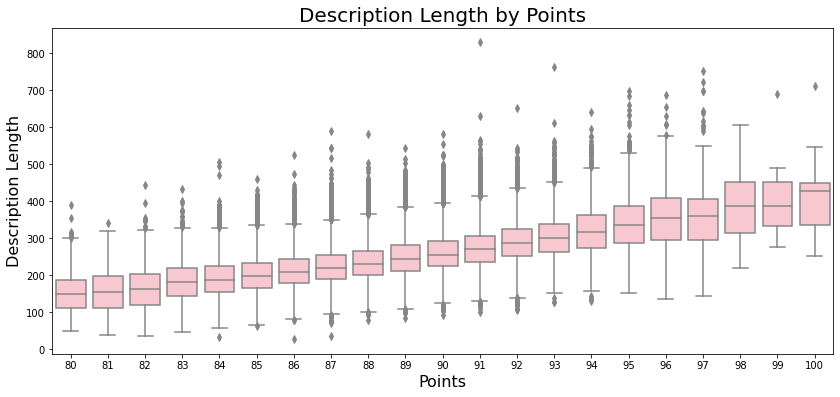

In [ ]:
#Description Length by Points
df = df.assign(desc_length = df['description'].apply(len))

plt.figure(figsize=(14,6))
g = sns.boxplot(x='points', y='desc_length', data=df,
                color='pink')
g.set_title('Description Length by Points', fontsize=20)
g.set_ylabel('Description Length', fontsize = 16) # Y label
g.set_xlabel('Points', fontsize = 16) # X label
plt.show()

In [ ]:
fig = px.scatter(df, x="desc_length", y="log_price",trendline="ols",
                 title="Scatter plot of log_price by desc_length")
fig.show()

In [ ]:
fig = px.box(df, y="desc_length", x="country",color="country",
              title="Boxplot of desc_length by country")
fig.show()

## Winery feature

In [ ]:
df.winery.nunique()

14850

In [ ]:
# top 20 wineries
df.winery.value_counts()[:20]

Testarossa               217
Williams Selyem          211
Wines & Winemakers       209
DFJ Vinhos               209
Chateau Ste. Michelle    193
Louis Latour             173
Concha y Toro            162
Columbia Crest           158
Kendall-Jackson          130
Siduri                   126
Gary Farrell             125
Georges Duboeuf          120
Lynmar                   118
Montes                   117
Robert Mondavi           112
Trapiche                 112
Undurraga                111
Santa Ema                110
Fess Parker              108
V. Sattui                107
Name: winery, dtype: int64

In [ ]:
list_of_wineries=df.winery.value_counts()[:20].index.tolist()
top_20_winery_df=df.loc[df['winery'].isin(list_of_wineries)].reset_index()
len(top_20_winery_df)

2928

In [ ]:
top_20_winery_df[["winery",'country']].drop_duplicates()

,winery,country
0,Testarossa,US
1,Robert Mondavi,US
4,Louis Latour,France
6,Undurraga,Chile
9,Chateau Ste. Michelle,US
10,Wines & Winemakers,Portugal
11,Georges Duboeuf,France
12,Fess Parker,US
13,Santa Ema,Chile
14,Kendall-Jackson,US


In [ ]:
fig = px.box(top_20_winery_df, y="log_price", x="winery",color="winery",
              title="Boxplot of log_price by winery")
fig.show()

In [ ]:
fig = px.box(top_20_winery_df, y="points", x="winery",color="winery",
              title="Boxplot of points by winery")
fig.show()

## Word Cloud

In [ ]:
from wordcloud import WordCloud, STOPWORDS
stopwords = set(STOPWORDS)
newStopWords = ['fruit', "Drink", "black", 'wine', 'drink']
stopwords.update(newStopWords)


### WORD CLOUD - based on Title column

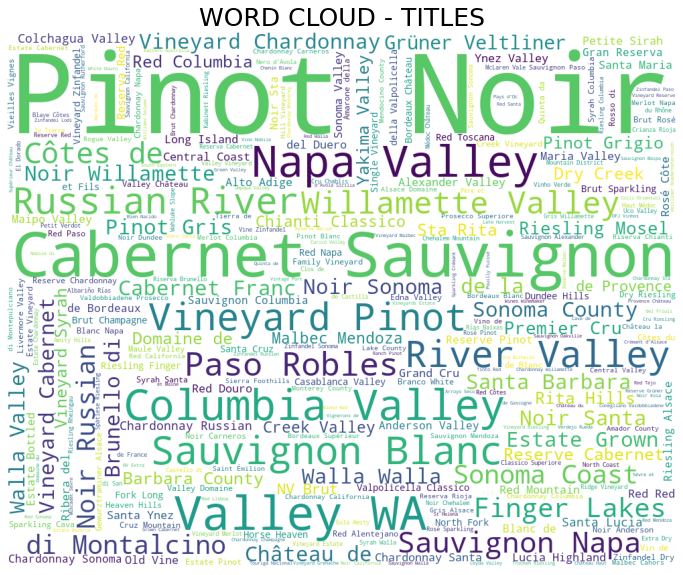

In [ ]:
wordcloud = WordCloud(
    background_color='white',
    stopwords=stopwords,
    max_words=300,
    max_font_size=200, 
    width=1000, height=800,
    random_state=42,
).generate(" ".join(df['title'].astype(str)))

print(wordcloud)
fig = plt.figure(figsize = (12,14))
plt.imshow(wordcloud)
plt.title("WORD CLOUD - TITLES",fontsize=25)
plt.axis('off')
plt.show()

### WORD CLOUD - based on description column

In [ ]:
wordcloud = WordCloud(
    background_color='pink',
    stopwords=stopwords,
    max_words=200,
    max_font_size=200, 
    width=1200, height=800,
    random_state=42
    ).generate(" ".join(df['description'].astype(str)))

print(wordcloud)
fig = plt.figure(figsize = (12,14))
plt.imshow(wordcloud)
plt.title("WORD CLOUD - DESCRIPTION",fontsize=25)
plt.axis('off')
plt.show()

## NLP Process

### text cleaning:

In [ ]:
import re

import unicodedata


def remove_accents(input_str):
    nfkd_form = unicodedata.normalize('NFKD', input_str)
    return u"".join([c for c in nfkd_form if not unicodedata.combining(c)])


def clean_text(text):
    # Remove all the special characters
    if str(text)=='nan' or text=="\\N":
        return ""
    if text is None:
        return ""

    # Substituting multiple spaces with single space
    text = re.sub(r'\s+', ' ', text, flags=re.I)

    text = re.sub(' +', ' ', text)
    text = text.replace(r"\N", '')
    text = text.replace(r"'", '')
    text = text.replace(r"`", '')
    text = re.sub(r'\W', ' ', str(text))
    text = re.sub(r"[^A-Za-z0-9(),!?\'`]", " ", text)
    text = re.sub(r"\'s", " \'s", text)
    text = re.sub(r"\'ve", " \'ve", text)
    text = re.sub(r"n\'t", " n\'t", text)
    text = re.sub(r"\'re", " \'re", text)
    text = re.sub(r"\'d", " \'d", text)
    text = re.sub(r"\'ll", " \'ll", text)
    text = re.sub(r",", " , ", text)
    text = re.sub(r"!", " ! ", text)
    text = re.sub(r"\(", " \( ", text)
    text = re.sub(r"\)", " \) ", text)
    text = re.sub(r"\?", " \? ", text)
    text = re.sub(r"\s{2,}", " ", text)
    text = remove_accents(text)

    return text.strip().lower()

### preprocess text columns:

In [ ]:
df['description'] = [clean_text(x) for x in df['description']]
df['title'] = [clean_text(x) for x in df['title']]

In [ ]:
df.head(2)

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery,log_price,desc_length
1,Portugal,this is ripe and fruity a wine that is smooth while still structured firm tannins are filled out with juicy red berry fruits and freshened with acidity its already drinkable although it will certainly be better from 2016,Avidagos,87,15.0,Douro,NaN,NaN,Roger Voss,@vossroger,quinta dos avidagos 2011 avidagos red douro,Portuguese Red,Quinta dos Avidagos,2.708050,227
2,US,tart and snappy the flavors of lime flesh and rind dominate some green pineapple pokes through with crisp acidity underscoring the flavors the wine was all stainless steel fermented,NaN,87,14.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,rainstorm 2013 pinot gris willamette valley,Pinot Gris,Rainstorm,2.639057,186


In [ ]:
df.columns

Index(['country', 'description', 'designation', 'points', 'price', 'province',
       'region_1', 'region_2', 'taster_name', 'taster_twitter_handle', 'title',
       'variety', 'winery', 'log_price', 'desc_length'],
      dtype='object')

## final df

In [ ]:
final_df=df[['country', 'description', 'points', 'price', 'province',
       'region_1', 'taster_name', 'title','variety', 'winery', 'log_price', 'desc_length']]
print(len(final_df))
final_df.isna().sum()/len(final_df)

115788


country        0.000000
description    0.000000
points         0.000000
price          0.000000
province       0.000000
region_1       0.126455
taster_name    0.209892
title          0.000000
variety        0.000009
winery         0.000000
log_price      0.000000
desc_length    0.000000
dtype: float64

In [ ]:
final_df=final_df.dropna()
len(final_df)

77014

In [ ]:
final_df.head(2)

,country,description,points,price,province,region_1,taster_name,title,variety,winery,log_price,desc_length
2,US,tart and snappy the flavors of lime flesh and rind dominate some green pineapple pokes through with crisp acidity underscoring the flavors the wine was all stainless steel fermented,87,14.0,Oregon,Willamette Valley,Paul Gregutt,rainstorm 2013 pinot gris willamette valley,Pinot Gris,Rainstorm,2.639057,186
3,US,pineapple rind lemon pith and orange blossom start off the aromas the palate is a bit more opulent with notes of honey drizzled guava and mango giving way to a slightly astringent semidry finish,87,13.0,Michigan,Lake Michigan Shore,Alexander Peartree,st julian 2013 reserve late harvest riesling lake michigan shore,Riesling,St. Julian,2.564949,199


## Sentimant analysis

### sentimant analysis for description

In [ ]:
import nltk
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


True

VADER’s SentimentIntensityAnalyzer() takes in a string and returns a dictionary of scores in each of four categories:

negative,
neutral,
positive,
compound (computed by normalizing the scores above)

In [ ]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer

SIA = SentimentIntensityAnalyzer()

final_df['polarity_score']=final_df.description.apply(lambda x:SIA.polarity_scores(x)['compound'])

final_df['sentiment']= np.nan
final_df.loc[final_df.polarity_score >= 0,'sentiment']='POSITIVE'
final_df.loc[final_df.polarity_score < 0,'sentiment']='NEGATIVE'

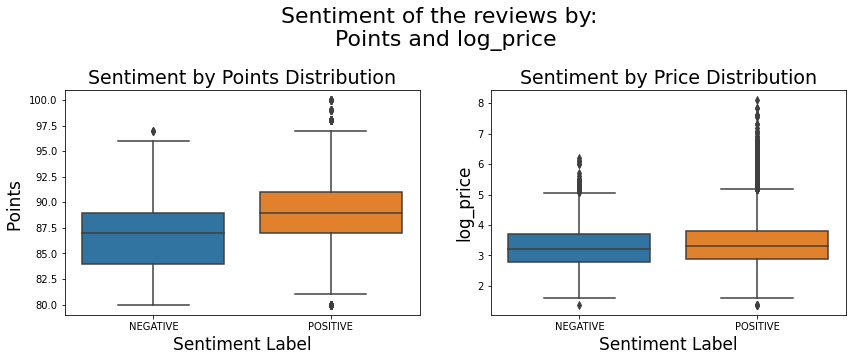

In [ ]:
plt.figure(figsize=(14,5))

plt.suptitle('Sentiment of the reviews by: \n Points and log_price', size=22)

plt.subplot(121)
ax = sns.boxplot(x='sentiment', y='points', data=final_df)
ax.set_title("Sentiment by Points Distribution", fontsize=19)
ax.set_ylabel("Points ", fontsize=17)
ax.set_xlabel("Sentiment Label", fontsize=17)

plt.subplot(122)
ax1= sns.boxplot(x='sentiment', y='log_price', data=final_df)
ax1.set_title("Sentiment by Price Distribution", fontsize=19)
ax1.set_ylabel("log_price", fontsize=17)
ax1.set_xlabel("Sentiment Label", fontsize=17)

plt.subplots_adjust(top = 0.75, wspace=.2)
plt.show()

In [ ]:
final_df.head(2)

,country,description,points,price,province,region_1,taster_name,title,variety,winery,log_price,desc_length,polarity_score,sentiment
2,US,tart and snappy the flavors of lime flesh and rind dominate some green pineapple pokes through with crisp acidity underscoring the flavors the wine was all stainless steel fermented,87,14.0,Oregon,Willamette Valley,Paul Gregutt,rainstorm 2013 pinot gris willamette valley,Pinot Gris,Rainstorm,2.639057,186,-0.128,NEGATIVE
3,US,pineapple rind lemon pith and orange blossom start off the aromas the palate is a bit more opulent with notes of honey drizzled guava and mango giving way to a slightly astringent semidry finish,87,13.0,Michigan,Lake Michigan Shore,Alexander Peartree,st julian 2013 reserve late harvest riesling lake michigan shore,Riesling,St. Julian,2.564949,199,0.340,POSITIVE


## Save\ Load final_df

In [ ]:
final_df.to_csv("/content/drive/MyDrive/Colab_Notebooks/final_df.csv")
final_df = pd.read_csv('/content/drive/MyDrive/Colab_Notebooks/final_df.csv', index_col=0)
final_df.head(2)

,country,description,points,price,province,region_1,taster_name,title,variety,winery,log_price,desc_length,polarity_score,sentiment
2,US,tart and snappy the flavors of lime flesh and rind dominate some green pineapple pokes through with crisp acidity underscoring the flavors the wine was all stainless steel fermented,87,14.0,Oregon,Willamette Valley,Paul Gregutt,rainstorm 2013 pinot gris willamette valley,Pinot Gris,Rainstorm,2.639057,186,-0.128,NEGATIVE
3,US,pineapple rind lemon pith and orange blossom start off the aromas the palate is a bit more opulent with notes of honey drizzled guava and mango giving way to a slightly astringent semidry finish,87,13.0,Michigan,Lake Michigan Shore,Alexander Peartree,st julian 2013 reserve late harvest riesling lake michigan shore,Riesling,St. Julian,2.564949,199,0.340,POSITIVE


# Modeling

In [ ]:
%%capture
pip install catboost

In [ ]:
from sklearn.model_selection import train_test_split
from catboost import CatBoostRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

## Model 1 -Baseline

In [ ]:
df2=final_df[['country', 'points', 'province', 'region_1','taster_name', 'variety', 'winery', 'log_price', 'desc_length','polarity_score', 'sentiment']]
df2[['country','province', 'taster_name','sentiment']].apply(lambda x: x.astype('category'))

X = df2.drop('log_price', axis=1)
y = df2.log_price
print(X.dtypes)
categorical_features_indices = np.where(X.dtypes == 'object')[0]

country            object
points              int64
province           object
region_1           object
taster_name        object
variety            object
winery             object
desc_length         int64
polarity_score    float64
sentiment          object
dtype: object


In [ ]:
X_train, X_validation, y_train, y_validation = train_test_split(X, y, train_size=0.95, random_state=42)
X_validation, X_test, y_validation, y_test = train_test_split(X_validation, y_validation, train_size=0.9, random_state=42)


X_train.shape, y_train.shape, X_validation.shape, X_test.shape

((73163, 10), (73163,), (3465, 10), (386, 10))

In [ ]:
model = CatBoostRegressor(
    iterations=400,
    learning_rate=0.1,
    loss_function="RMSE"
)
model.fit(
    X_train, y_train,
    cat_features=categorical_features_indices,
    eval_set=(X_validation, y_validation),
    verbose=100
)
print('Model is fitted: ' + str(model.is_fitted()))
print('Model params:')
print(model.get_params())

0:	learn: 0.6146005	test: 0.6093326	best: 0.6093326 (0)	total: 310ms	remaining: 2m 3s
100:	learn: 0.3508977	test: 0.3392538	best: 0.3392538 (100)	total: 15.8s	remaining: 46.8s
200:	learn: 0.3400082	test: 0.3299263	best: 0.3299263 (200)	total: 35.2s	remaining: 34.8s
300:	learn: 0.3349681	test: 0.3268080	best: 0.3268080 (300)	total: 51.8s	remaining: 17s
399:	learn: 0.3307453	test: 0.3243007	best: 0.3243007 (399)	total: 1m 7s	remaining: 0us

bestTest = 0.3243006831
bestIteration = 399

Model is fitted: True
Model params:
{'iterations': 400, 'learning_rate': 0.1, 'loss_function': 'RMSE'}


In [ ]:
pred=model.predict(X_test)

rmse = (np.sqrt(mean_squared_error(y_test, pred)))
r2 = r2_score(y_test, pred)
print("Testing performance")
print("RMSE: {:.2f}".format(rmse))
print("R2: {:.2f}".format(r2))


Testing performance
RMSE: 0.32
R2: 0.73


Text(0.5, 0, 'CatBoost Feature Importance')

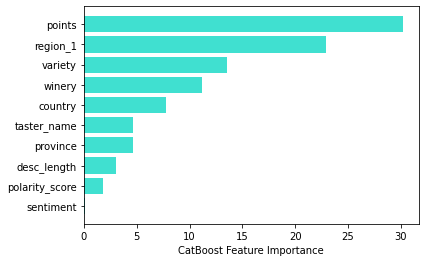

In [ ]:
sorted_feature_importance = model.feature_importances_.argsort()

plt.barh(X_train.columns[sorted_feature_importance], 
        model.feature_importances_[sorted_feature_importance], 
        color='turquoise')
plt.xlabel("CatBoost Feature Importance")

## Model 2 - using only textual features- title, description and taster name, using tf-idf

In [ ]:

text_df=final_df[["title", "description","taster_name", "log_price"]].copy()
text_df["combined_text"]= final_df["title"]+" "+final_df["description"]+" "+final_df["taster_name"]
text_df_for_model=text_df[["combined_text", "log_price"]]

text_df_for_model.head(5)


,combined_text,log_price
2,rainstorm 2013 pinot gris willamette valley tart and snappy the flavors of lime flesh and rind dominate some green pineapple pokes through with crisp acidity underscoring the flavors the wine was all stainless steel fermented Paul Gregutt,2.639057
3,st julian 2013 reserve late harvest riesling lake michigan shore pineapple rind lemon pith and orange blossom start off the aromas the palate is a bit more opulent with notes of honey drizzled guava and mango giving way to a slightly astringent semidry finish Alexander Peartree,2.564949
4,sweet cheeks 2012 vintners reserve wild child block pinot noir willamette valley much like the regular bottling from 2012 this comes across as rather rough and tannic with rustic earthy herbal characteristics nonetheless if you think of it as a pleasantly unfussy country wine its a good companion to a hearty winter stew Paul Gregutt,4.174387
5,tandem 2011 ars in vitro tempranillo merlot navarra blackberry and raspberry aromas show a typical navarran whiff of green herbs and in this case horseradish in the mouth this is fairly full bodied with tomatoey acidity spicy herbal flavors complement dark plum fruit while the finish is fresh but grabby Michael Schachner,2.708050
6,terre di giurfo 2013 belsito frappato vittoria heres a bright informal red that opens with aromas of candied berry white pepper and savory herb that carry over to the palate its balanced with fresh acidity and soft tannins Kerin O’Keefe,2.772589


### demonstrate values from tf-df

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

X = text_df_for_model.iloc[:, 0].values


tfidf = TfidfVectorizer(min_df=3)
tfidf.fit(list(X))
feature_names = tfidf.get_feature_names()

def get_ifidf_for_words(text):
    tfidf_matrix= tfidf.transform([text]).todense()
    feature_index = tfidf_matrix[0,:].nonzero()[1]
    tfidf_scores = zip([feature_names[i] for i in feature_index], [tfidf_matrix[0, x] for x in feature_index])
    return dict(tfidf_scores)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



In [ ]:
text = text_df_for_model.combined_text.iloc[0]
print(text, '\n')
get_ifidf_for_words(text)

rainstorm 2013 pinot gris willamette valley tart and snappy the flavors of lime flesh and rind dominate some green pineapple pokes through with crisp acidity underscoring the flavors the wine was all stainless steel fermented Paul Gregutt 



{'2013': 0.10052835725224094,
 'acidity': 0.08476848865139844,
 'all': 0.1401376238900383,
 'and': 0.07316548467184011,
 'crisp': 0.12117820810689976,
 'dominate': 0.20577755964196978,
 'fermented': 0.18451800233407684,
 'flavors': 0.1302203312393153,
 'flesh': 0.22374745349955805,
 'green': 0.13440694331854533,
 'gregutt': 0.11180904424658832,
 'gris': 0.18028354284496764,
 'lime': 0.1525746965609061,
 'of': 0.044573324502425994,
 'paul': 0.11047227972915184,
 'pineapple': 0.17162789369574477,
 'pinot': 0.10653621842955749,
 'pokes': 0.33199715193524804,
 'rainstorm': 0.34231579813067586,
 'rind': 0.20551284827000474,
 'snappy': 0.22445598474772543,
 'some': 0.13579948386362103,
 'stainless': 0.210605069984888,
 'steel': 0.20894200657017786,
 'tart': 0.13970552237676087,
 'the': 0.12770589035711002,
 'through': 0.11863295093075325,
 'underscoring': 0.3239933881373194,
 'valley': 0.08832755909169564,
 'was': 0.18691719525271758,
 'willamette': 0.16624850834948418,
 'wine': 0.0622966199

### create tf-idf matrix and train model

In [ ]:
X = text_df_for_model.iloc[:, 0].values
y = text_df_for_model.iloc[:, 1].values

# Building a TF IDF matrix
td = TfidfVectorizer(max_features = 600)
X = td.fit_transform(X).toarray()

In [ ]:
#split to train,validation and test datasets

X_train, X_validation, y_train, y_validation = train_test_split(X, y, train_size=0.95, random_state=42)
X_validation, X_test, y_validation, y_test = train_test_split(X_validation, y_validation, train_size=0.9, random_state=42)


X_train.shape, y_train.shape, X_validation.shape, X_test.shape


((73163, 600), (73163,), (3465, 600), (386, 600))

In [ ]:
model2 = CatBoostRegressor(
    iterations=600,
    learning_rate=0.1,
    loss_function="RMSE"
)
model2.fit(
    X_train, y_train,
#    cat_features=categorical_features_indices,
    eval_set=(X_validation, y_validation),
    verbose=100
)
print('Model is fitted: ' + str(model2.is_fitted()))
print('model2 params:')
print(model2.get_params())

0:	learn: 0.6362723	test: 0.6304650	best: 0.6304650 (0)	total: 283ms	remaining: 2m 49s
100:	learn: 0.4691256	test: 0.4630635	best: 0.4630635 (100)	total: 24s	remaining: 1m 58s
200:	learn: 0.4414713	test: 0.4398989	best: 0.4398989 (200)	total: 46.7s	remaining: 1m 32s
300:	learn: 0.4258928	test: 0.4298582	best: 0.4298582 (300)	total: 1m 10s	remaining: 1m 10s
400:	learn: 0.4147800	test: 0.4236481	best: 0.4236481 (400)	total: 1m 33s	remaining: 46.4s
500:	learn: 0.4058725	test: 0.4194919	best: 0.4194686 (497)	total: 1m 55s	remaining: 22.8s
599:	learn: 0.3984212	test: 0.4159934	best: 0.4159934 (599)	total: 2m 17s	remaining: 0us

bestTest = 0.4159933879
bestIteration = 599

Model is fitted: True
model2 params:
{'iterations': 600, 'learning_rate': 0.1, 'loss_function': 'RMSE'}


In [ ]:
pred=model2.predict(X_test)

rmse = (np.sqrt(mean_squared_error(y_test, pred)))
r2 = r2_score(y_test, pred)
print("Testing performance")
print("RMSE: {:.2f}".format(rmse))
print("R2: {:.2f}".format(r2))



Testing performance
RMSE: 0.42
R2: 0.54


## Model 3- pretrained model for embeddings

In [ ]:
%%capture
pip install -U sentence-transformers

In [ ]:
from sentence_transformers import SentenceTransformer
model = SentenceTransformer('all-MiniLM-L6-v2',device='cuda')

#Our sentences we like to encode
text_corpus = text_df["combined_text"].tolist()

#Sentences are encoded by calling model.encode()
embeddings = model.encode(text_corpus, batch_size=2048, show_progress_bar=True)

Downloading:   0%|          | 0.00/1.18k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/10.6k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/612 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/116 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/350 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/13.2k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/349 [00:00<?, ?B/s]

Batches:   0%|          | 0/38 [00:00<?, ?it/s]

In [ ]:
y = text_df_for_model.log_price
X_train, X_validation, y_train, y_validation = train_test_split(embeddings, y, train_size=0.95, random_state=42)
X_validation, X_test, y_validation, y_test = train_test_split(X_validation, y_validation, train_size=0.9, random_state=42)


X_train.shape, y_train.shape, X_validation.shape, X_test.shape

((73163, 384), (73163,), (3465, 384), (386, 384))

In [ ]:
model3 = CatBoostRegressor(
    iterations=1000,
    learning_rate=0.1,
    loss_function="RMSE"
)
model3.fit(
    X_train, y_train,
#    cat_features=categorical_features_indices,
    eval_set=(X_validation, y_validation),
    verbose=100
)
print('Model is fitted: ' + str(model3.is_fitted()))
print('model3 params:')
print(model3.get_params())

0:	learn: 0.6394089	test: 0.6333906	best: 0.6333906 (0)	total: 515ms	remaining: 8m 34s
100:	learn: 0.5030701	test: 0.4989546	best: 0.4989546 (100)	total: 40.9s	remaining: 6m 3s
200:	learn: 0.4679786	test: 0.4737305	best: 0.4737305 (200)	total: 1m 1s	remaining: 4m 5s
300:	learn: 0.4440366	test: 0.4598987	best: 0.4598987 (300)	total: 1m 19s	remaining: 3m 4s
400:	learn: 0.4251730	test: 0.4506242	best: 0.4506242 (400)	total: 1m 36s	remaining: 2m 24s
500:	learn: 0.4091504	test: 0.4444154	best: 0.4444154 (500)	total: 1m 54s	remaining: 1m 53s
600:	learn: 0.3949640	test: 0.4389138	best: 0.4389138 (600)	total: 2m 13s	remaining: 1m 28s
700:	learn: 0.3821750	test: 0.4345573	best: 0.4345573 (700)	total: 2m 32s	remaining: 1m 4s
800:	learn: 0.3706417	test: 0.4314596	best: 0.4314596 (800)	total: 2m 48s	remaining: 41.9s
900:	learn: 0.3598200	test: 0.4276654	best: 0.4276654 (900)	total: 3m 5s	remaining: 20.4s
999:	learn: 0.3502118	test: 0.4246497	best: 0.4246497 (999)	total: 3m 22s	remaining: 0us

best

In [ ]:
pred=model3.predict(X_test)

rmse = (np.sqrt(mean_squared_error(y_test, pred)))
r2 = r2_score(y_test, pred)
print("Testing performance-model 3")
print("RMSE: {:.2f}".format(rmse))
print("R2: {:.2f}".format(r2))

Testing performance-model 3
RMSE: 0.42
R2: 0.53


In [ ]:
embeddings_df=pd.DataFrame(embeddings)
embeddings_df.shape

(77014, 384)

## Model 4- combined features and embeddings for prediction

In [ ]:
embeddings_df.to_csv("/content/drive/MyDrive/Colab_Notebooks/embeddings_df.csv")
embeddings_df = pd.read_csv('/content/drive/MyDrive/Colab_Notebooks/embeddings_df.csv', index_col=0)
final_df = pd.read_csv('/content/drive/MyDrive/Colab_Notebooks/final_df.csv', index_col=0)


In [ ]:
final_df = final_df.reset_index()
embeddings_df = embeddings_df.reset_index()

In [ ]:
embeddings_df["country"]=final_df["country"]
embeddings_df["points"]=final_df["points"]
embeddings_df["province"]=final_df["province"]
embeddings_df["region_1"]=final_df["region_1"]
embeddings_df["winery"]=final_df["winery"]
embeddings_df["desc_length"]=final_df["desc_length"]
embeddings_df["log_price"]=final_df["log_price"]
embeddings_df["polarity_score"]=final_df["polarity_score"]
embeddings_df["taster_name"]=final_df["taster_name"]

embeddings_df.shape

(77014, 394)

In [ ]:
embeddings_df.head(2)

,index,0,1,2,3,4,5,6,7,8,...,383,country,points,province,region_1,winery,desc_length,log_price,polarity_score,taster_name
0,0,-0.028282,-0.073757,0.052554,-0.003634,0.038935,0.023627,0.071178,-0.045388,0.056673,...,-0.003267,US,87,Oregon,Willamette Valley,Rainstorm,186,2.639057,-0.128,Paul Gregutt
1,1,0.029328,0.031085,0.068697,0.024808,0.000159,0.063048,0.020541,-0.078905,0.008918,...,-0.012694,US,87,Michigan,Lake Michigan Shore,St. Julian,199,2.564949,0.340,Alexander Peartree


In [ ]:
embeddings_df[['country','province',"region_1","winery","taster_name"]].apply(lambda x: x.astype('category'))
embeddings_df.shape

(77014, 394)

In [ ]:
X = embeddings_df.drop('log_price', axis=1)
y = embeddings_df.log_price
categorical_features_indices = np.where(X.dtypes == 'object')[0]
categorical_features_indices

array([385, 387, 388, 389, 392])

In [ ]:
X_train, X_validation, y_train, y_validation = train_test_split(X, y, train_size=0.95, random_state=42)
X_validation, X_test, y_validation, y_test = train_test_split(X_validation, y_validation, train_size=0.9, random_state=42)


X_train.shape, y_train.shape, X_validation.shape, X_test.shape

((73163, 393), (73163,), (3465, 393), (386, 393))

In [ ]:
model4 = CatBoostRegressor(
    iterations=1500,
    learning_rate=0.1,
    loss_function="RMSE"
)
model4.fit(
    X_train, y_train,
    cat_features=categorical_features_indices,
    eval_set=(X_validation, y_validation),
    verbose=100
)
print('Model is fitted: ' + str(model4.is_fitted()))
print('model4 params:')
print(model4.get_params())

0:	learn: 0.6141437	test: 0.6086241	best: 0.6086241 (0)	total: 311ms	remaining: 7m 46s
100:	learn: 0.3601578	test: 0.3497233	best: 0.3497233 (100)	total: 26.5s	remaining: 6m 7s
200:	learn: 0.3427222	test: 0.3364989	best: 0.3364989 (200)	total: 52.7s	remaining: 5m 40s
300:	learn: 0.3305202	test: 0.3302485	best: 0.3302485 (300)	total: 1m 18s	remaining: 5m 11s
400:	learn: 0.3206565	test: 0.3265919	best: 0.3265919 (400)	total: 1m 43s	remaining: 4m 42s
500:	learn: 0.3116609	test: 0.3235761	best: 0.3235761 (500)	total: 2m 9s	remaining: 4m 19s
600:	learn: 0.3038628	test: 0.3215171	best: 0.3215171 (600)	total: 2m 35s	remaining: 3m 52s
700:	learn: 0.2965429	test: 0.3194963	best: 0.3194963 (700)	total: 3m	remaining: 3m 26s
800:	learn: 0.2896201	test: 0.3180234	best: 0.3180234 (800)	total: 3m 26s	remaining: 2m 59s
900:	learn: 0.2830650	test: 0.3164714	best: 0.3164642 (899)	total: 3m 51s	remaining: 2m 33s
1000:	learn: 0.2771112	test: 0.3153839	best: 0.3153839 (1000)	total: 4m 15s	remaining: 2m 7s


In [ ]:
pred=model4.predict(X_test)

rmse = (np.sqrt(mean_squared_error(y_test, pred)))
r2 = r2_score(y_test, pred)
print("Testing performance")
print("RMSE: {:.2f}".format(rmse))
print("R2: {:.2f}".format(r2))

Testing performance
RMSE: 0.32
R2: 0.74


# Error Analysis

In [ ]:
error_analysis=pd.DataFrame(X_test)

In [ ]:
error_analysis["pred_log_price"]=model.predict(error_analysis)
error_analysis['real_price'] = np.exp(y_test)
error_analysis['predicted_price'] = np.exp(error_analysis['pred_log_price'])

In [ ]:
error_analysis["diff"] = (np.abs(error_analysis.real_price - error_analysis.predicted_price))
error_analysis.head(2)

,country,points,province,region_1,taster_name,variety,winery,desc_length,polarity_score,sentiment,pred_log_price,real_price,predicted_price,diff
523,US,91,Oregon,Chehalem Mountains,Paul Gregutt,Pinot Noir,Ruby,339,0.5859,POSITIVE,3.699545,65.0,40.428916,24.571084
35764,Spain,86,Northern Spain,Rioja,Michael Schachner,Tempranillo,Campo Viejo,245,0.8176,POSITIVE,2.517596,12.0,12.398759,0.398759


In [ ]:
error_analysis["diff_percentage"] = (np.abs(error_analysis.real_price - error_analysis.predicted_price))/error_analysis.real_price

print(error_analysis["diff_percentage"])


bin_labels= ['0% - 20%', '20% - 40%', '40% - 60%', '60% - 80%', '80% - 100%']
error_analysis["price_quantile"] = pd.qcut(error_analysis["real_price"],
                              q=[0, .2, .4, .6, .8, 1],
                              labels=bin_labels)

523       0.378017
35764     0.033230
17185     0.206231
120809    0.163541
26998     0.246771
            ...   
65858     0.123794
104799    0.271043
126904    0.072010
53172     0.233320
101953    0.168145
Name: diff_percentage, Length: 386, dtype: float64


In [ ]:
fig2 = px.box(error_analysis, y="diff_percentage", x="price_quantile",color="price_quantile",
              title="diff percentage by price precentile")
fig2.show()

In [ ]:
fig = px.box(error_analysis, y="diff_percentage", x="country",color="country",
              title="diff percentage by country")
fig.show()

In [ ]:
great_predictions=error_analysis[error_analysis["diff"]<0.1]
great_predictions.head(10)

,country,points,province,region_1,taster_name,variety,winery,desc_length,polarity_score,sentiment,pred_log_price,real_price,predicted_price,diff,diff_percentage,price_quantile
119083,Italy,91,Tuscany,Toscana,Kerin O’Keefe,Sangiovese,Il Borro,266,0.7003,POSITIVE,3.690484,40.0,40.064223,0.064223,0.001606,60% - 80%
70065,US,89,New York,Finger Lakes,Anna Lee C. Iijima,Champagne Blend,Château Frank,249,0.3612,POSITIVE,3.401745,30.0,30.016441,0.016441,0.000548,40% - 60%
3268,France,86,Bordeaux,Bordeaux Blanc,Roger Voss,Bordeaux-style White Blend,Château Buisson-Redon,196,0.0772,POSITIVE,2.636645,14.0,13.966275,0.033725,0.002409,0% - 20%
43319,Italy,87,Central Italy,Montefalco Sagrantino,Kerin O’Keefe,Sagrantino,Fongoli,237,0.8625,POSITIVE,3.688817,40.0,39.997517,0.002483,0.000062,60% - 80%
79185,France,88,Southwest France,Fronton,Roger Voss,Negrette,Château Laurou,246,0.7351,POSITIVE,2.768262,16.0,15.930927,0.069073,0.004317,0% - 20%
117394,Argentina,85,Mendoza Province,Mendoza,Michael Schachner,Malbec,Kaiken,241,0.4284,POSITIVE,2.641071,14.0,14.028217,0.028217,0.002016,0% - 20%


In [ ]:
error_analysis[error_analysis["diff"]>100].head(5)

,country,points,province,region_1,taster_name,variety,winery,desc_length,polarity_score,sentiment,pred_log_price,real_price,predicted_price,diff,diff_percentage,price_quantile
8858,France,95,Bordeaux,Margaux,Roger Voss,Bordeaux-style Red Blend,Château Rauzan-Ségla,276,0.8074,POSITIVE,5.161205,55.0,174.374537,119.374537,2.170446,80% - 100%
82709,France,93,Bordeaux,Bordeaux Blanc,Roger Voss,Bordeaux-style White Blend,Château Margaux,193,0.8910,POSITIVE,4.492136,190.0,89.312042,100.687958,0.529937,80% - 100%
35384,France,92,Bordeaux,Pomerol,Roger Voss,Bordeaux-style Red Blend,Château Clinet,150,0.5574,POSITIVE,4.141369,265.0,62.888831,202.111169,0.762684,80% - 100%
35336,Australia,93,South Australia,Clare Valley,Joe Czerwinski,Cabernet Sauvignon,Jim Barry,301,0.9336,POSITIVE,3.668229,140.0,39.182470,100.817530,0.720125,80% - 100%


# Wine recommendation-just for fun because we love wine :)

In [ ]:
final_df = pd.read_csv('/content/drive/MyDrive/Colab_Notebooks/final_df.csv', index_col=0)
wine_data = final_df.sample(n=10000,ignore_index=True)
wine_data.head(2)

,country,description,points,price,province,region_1,taster_name,title,variety,winery,log_price,desc_length,polarity_score,sentiment
0,Argentina,mint tea and light plum aromas are mild at bes...,82,16.0,Mendoza Province,Vista Flores,Michael Schachner,antucura 2011 cabernet sauvignon vista flores,Cabernet Sauvignon,Antucura,2.772589,167,0.8402,POSITIVE
1,Spain,the nose on this crianza is front loaded with ...,90,32.0,Northern Spain,Ribera del Duero,Michael Schachner,garc a figuero 2014 tinto 12 crianza ribera de...,Tempranillo,García Figuero,3.465736,330,0.0000,POSITIVE


In [ ]:
len(wine_data)

10000

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

tfidf = TfidfVectorizer(stop_words='english')
wine_data['description'] = wine_data['description'].fillna('')
tfidf_matrix = tfidf.fit_transform(wine_data['description'])

In [ ]:
from sklearn.metrics.pairwise import linear_kernel
cosine_sim = linear_kernel(tfidf_matrix, tfidf_matrix)

indices = pd.Series(wine_data.index, index=wine_data['title']).drop_duplicates()

def get_recommendations(title, cosine_sim=cosine_sim):
    idx = indices[title]
    sim_scores = list(enumerate(cosine_sim[idx]))
    sim_scores = sorted(sim_scores, key=lambda x: x[1], reverse=True)
    sim_scores = sim_scores[1:11]
    wine_indices = [i[0] for i in sim_scores]
    return wine_data[['title','description']].iloc[wine_indices]

In [ ]:
wine_data.head()

,country,description,points,price,province,region_1,taster_name,title,variety,winery,log_price,desc_length,polarity_score,sentiment
0,Argentina,mint tea and light plum aromas are mild at bes...,82,16.0,Mendoza Province,Vista Flores,Michael Schachner,antucura 2011 cabernet sauvignon vista flores,Cabernet Sauvignon,Antucura,2.772589,167,0.8402,POSITIVE
1,Spain,the nose on this crianza is front loaded with ...,90,32.0,Northern Spain,Ribera del Duero,Michael Schachner,garc a figuero 2014 tinto 12 crianza ribera de...,Tempranillo,García Figuero,3.465736,330,0.0000,POSITIVE
2,Spain,blackberry and plum aromas are friendly and we...,89,18.0,Northern Spain,Toro,Michael Schachner,telmo rodr guez 2013 g dhesa gago toro,Tempranillo,Telmo Rodríguez,2.890372,245,0.7050,POSITIVE
3,Italy,this opens with aromas suggesting white flower...,87,13.0,Northeastern Italy,Collio,Kerin O’Keefe,bollini 2014 barricato 40 chardonnay collio,Chardonnay,Bollini,2.564949,182,0.5719,POSITIVE
4,Italy,made in collaboration between frescobaldi and ...,89,146.0,Tuscany,Costa Toscana,Kerin O’Keefe,marchesi de frescobaldi 2015 gorgona white cos...,White Blend,Marchesi de' Frescobaldi,4.983607,257,-0.4767,NEGATIVE


In [ ]:
get_recommendations('antucura 2011 cabernet sauvignon vista flores')

,title,description
8257,mureda 2015 made with organic grapes cabernet ...,murky grassy berry aromas and a whiff of cinna...
7027,betz family 2014 p re de famille cabernet sauv...,boysenberry black fruit bay leaf plum and spic...
9997,icono 2013 selecci n red valencia,dark berry aromas chocolate and grit define th...
7935,three rivers 2012 cabernet sauvignon walla wal...,aromas of wood spice plum and herb lead to bla...
4069,larchago 2008 pagos de tahola reserva rioja,flat stewy prune like aromas are low on life b...
5395,finca del marquesado 2008 gran reserva rioja,earthy aromas of brandied cherry spiced berry ...
2154,slow press 2015 cabernet sauvignon california,generous and flavorful this is one of the best...
2248,os winery 2013 sonas merlot yakima valley,high toned aromas of raspberries mint nori and...
5906,alidis 2013 tinto 6 meses en barrica ribera de...,the wine has a murky burgundy color and earthy...
2133,bodegas escudero 2015 solar de becquer rioja,punchy raspberry and red plum aromas are light...


In [ ]:
get_recommendations('telmo rodr guez 2013 g dhesa gago toro')

,title,description
9684,bodegas roda 2006 roda i reserva rioja,lush and dark with balance throughout the nose...
3775,salvatore principe 2011 malbec mendoza,the welcoming aromas of red berry and cherry a...
2082,resalte 2010 crianza ribera del duero,calm aromas of plum berry fruits and dried spi...
2595,vi a mayor 2007 crianza ribera del duero,spice and light berry aromas form a simple but...
120,rejadorada 2012 tinto roble toro,smoky plum and red berry aromas come with a hi...
3081,patrocinio 2010 zinio crianza rioja,berry and plum aromas are clean and composed t...
2441,vi a palaciega 2007 crianza rioja,briary berry and milk chocolate aromas lead to...
7418,vi a mayor 2010 secreto vendimia seleccionada ...,raspberry and plum aromas are clean and welcom...
2922,pingao 2014 rioja,compact rubbery aromas of plum and berry come ...
5316,conde de altava 2009 crianza rioja,dusty berry fruit aromas blend with milk choco...


In [ ]:
get_recommendations('bollini 2014 barricato 40 chardonnay collio')

,title,description
1958,cocchi 2009 pas dos sparkling alta langa,bright and linear this offers delicate aromas ...
5452,la valle 2007 naturalis extra brut sparkling f...,this frothy wine opens with floral aromas that...
974,drusian nv col fondo prosecco treviso,aromas of yellow apple and a yeasty whiff of b...
2891,alois lageder 2014 m ller thurgau alto adige v...,light and vibrant this opens with aromas of fr...
814,tommasi 2016 le volpare soave classico,this crisp straightforward white has delicate ...
2101,feudo maccari 2016 grillo terre siciliane,yellow wild flower and ripe orchard fruit arom...
5056,tenuta roveglia 2015 wighel lugana,delicately scented this opens with aromas of w...
5179,le battistelle 2012 soave classico,enticing aromas of white flower ripe orchard f...
8544,fattori 2012 motto piane soave,this full bodied white opens with aromas of dr...
5035,bellavista 2011 sat n chardonnay franciacorta,this opens with aromas suggesting toasted nut ...
